# Exploring
This is me exploring approaches to solve sudoku visually. It's basically me stumbling through the process, so don't expect any clean well structured code in here.

I'm starting in with no experience of OpenCV and ML. I had started trying tesseract to avoid getting too close to ML, but that didn't fit too well here (Even after playing about with different PSMs etc). Either way, it's probably like taking a jackhammer to a pocketwatch... or something like that... it's much too smart for what I need (Turns out digit recognition is the hello world of ML which is handy :) )

## More specific notebooks
1. [Digit recognition model](./digits.ipynb)
2. [Digit orientation model](./orientation.ipynb)
3. [Solving sudoku](./solve.ipynb)

## Approach
I think I've got the approach down to the following (I'm mostly writing this for myself as a TODO list to now build something end to end):

1. Convert the image to a binary image.
2. (Potentially) Crop to a central area (e.g. If the eventual UI draws a rectangle where the user should place the sudoku grid in the frame).
3. Find the sudoku grid:
    1. This should be the largest, solid contour which is relatively near the center of the frame.
    2. Could also only consider contours with 4 points when simplified.
4. Grab the corners and morph the image into a 252x252 square (Because the models take a 28x28 image (28 x 9 = 252)).
5. Find the cells with numbers (This is still pretty unexplored, as I've mostly been trying to remove the grid rather than just find the numbers. Though removing the grid might actually work ok with the homemade models anyway... so might give that a try)
    1. A number could be determined by:
        1. Some ratio of black vs white pixels
        2. Another central contour which has a pretty "even" bounding box (e.g. Each side is a similar distance from the edge)
        3. Something along those lines...
6. Pass the numbers to the models to get orientation and digits.
7. Solve the puzzle.
8. Draw the numbers and reverse the morph (and rotation if any) to place them in their right place on the original image.
9. Do all this fast enough to be realtime..

## Random Notes

1. Clean image
    1. Currently grayscale & threshold. Perhaps be smarter here, either with the Binarization here: https://docs.opencv.org/4.x/d7/d4d/tutorial_py_thresholding.html, or some kind of bilateral filtering
    2. Though when trying to be smarter here, the orientation (via Tesseract OCR struggled here), so doing some extra cleanup in find cells instead (Removing lines as at this point they should be easier to find)
3. Find grid
    1. https://docs.opencv.org/4.x/d6/d10/tutorial_py_houghlines.html Something here could be useful
    2. Currently using contours
5. Morph Grid
6. Find Cells
7. Find numbers in cells
    1. Currently having some issues due to the less "clean" image

In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from math import ceil, sqrt

IMAGE_COUNT = 15
COLUMNS = 3

images = [
    (
        f"{i+1:02}",
        cv2.imread(f"./images/{i+1:02}.jpg"),
    )
    for i in range(IMAGE_COUNT)
]

def show_images(images, cmap=None, columns=COLUMNS):
    plt.figure(figsize=(15,20))
    for index, [title, img] in enumerate(images):
        plt.subplot(ceil(len(images) / columns), columns, index+1)
        plt.imshow(img, cmap=cmap)
        plt.title(title)

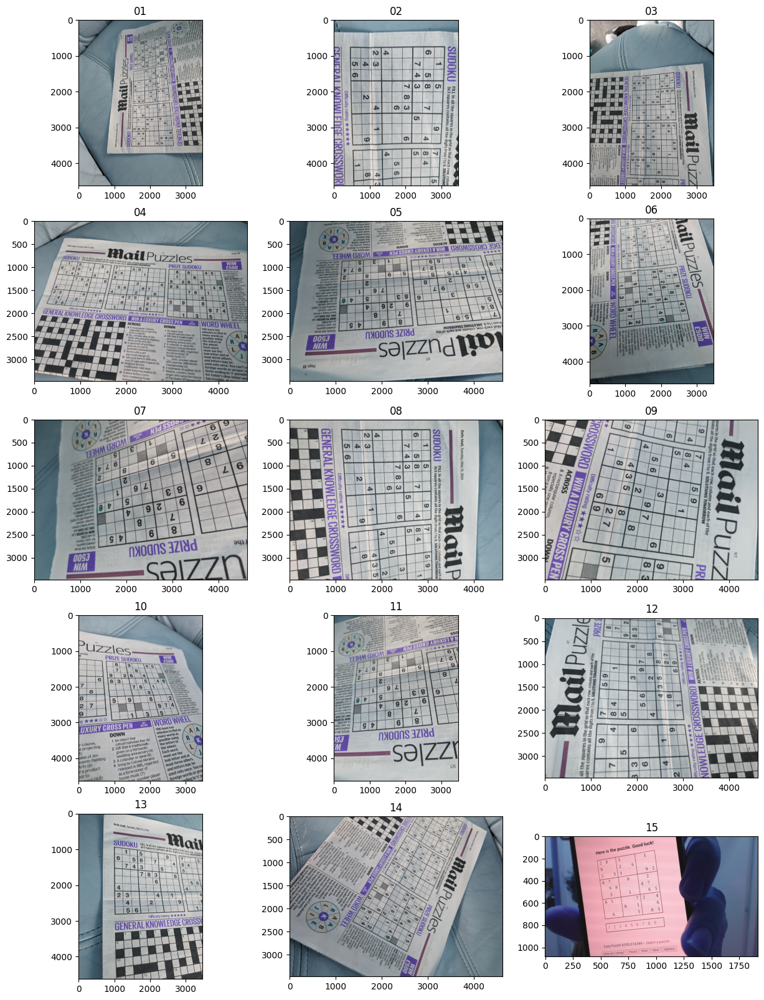

In [2]:
show_images(images)

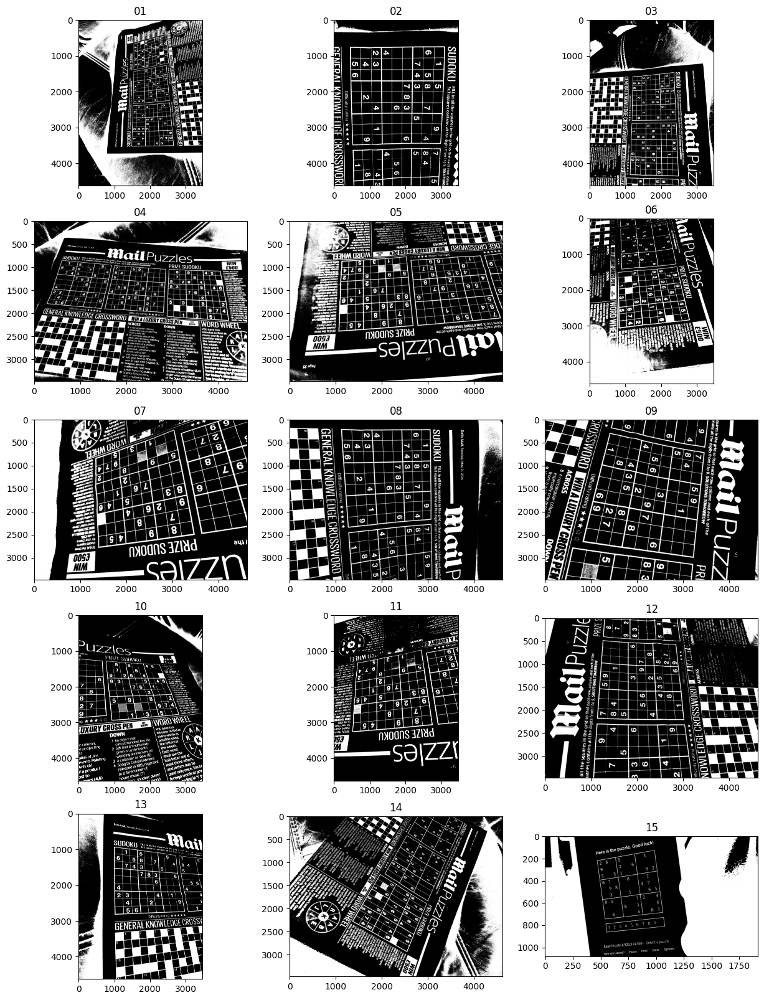

In [3]:
greys = [
    (title, cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)) 
    for title, img in images
]
# Absolute
thresh = [
    (title, cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)[1])
    for title, img in greys
]

# Otsu
# thresh = [
#     (title, cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1])
#     for title, img in greys
# ]

# Blur + Otsu
# thresh = [
#     (
#         title,
#         cv2.threshold(
#             cv2.GaussianBlur(img, (11,11), 0),
#             0,
#             255,
#             cv2.THRESH_BINARY + cv2.THRESH_OTSU
#         )[1],
#     )
#     for title, img in greys
# ]

# # Should play with these some more
# ADAPTIVE_BLOCK_SIZE = 39
# C = 11

# thresh = [
#     (
#         title,
#         cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,ADAPTIVE_BLOCK_SIZE,C)
#     )
#     for title, img in greys
# ]

# The thresh functions tend to have an _INV variant, so this probably
# isn't necessary, but too lazy to update the "inverted" variable all over
inverted = [
    (title, np.invert(img))
    for title, img in thresh
]

show_images(inverted, 'grey')

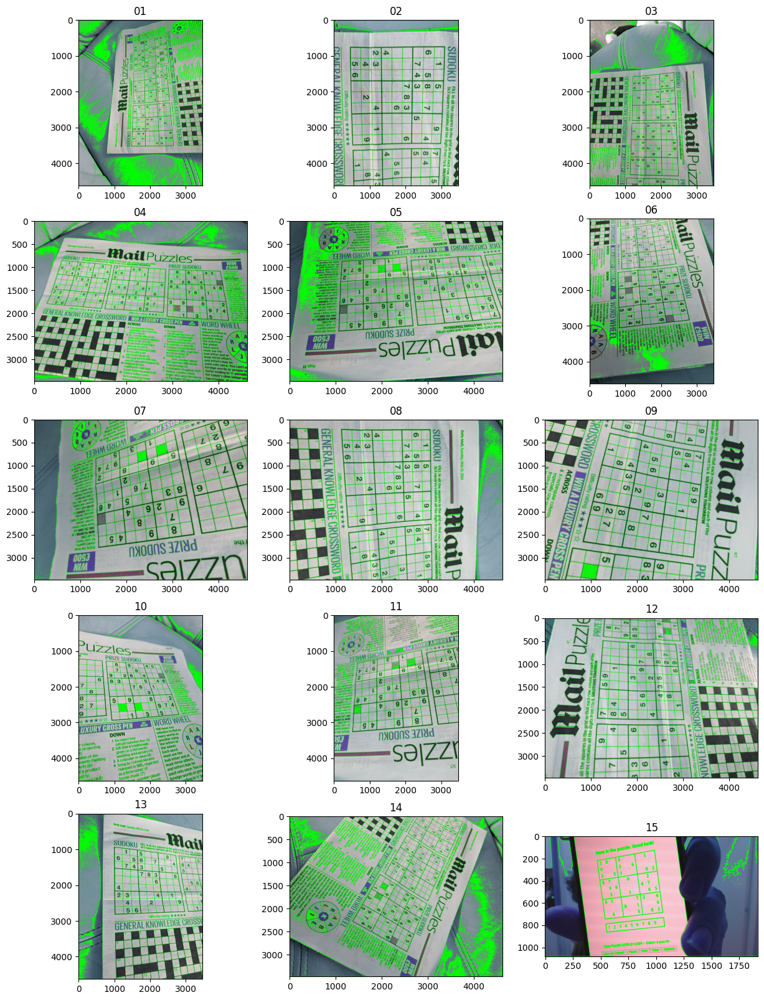

In [4]:
contours = [
    cv2.findContours(inv, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)[0]
    for (_, inv) in inverted
]
images_cpy = [(title, np.copy(img)) for title, img in images]
for (title, img), cnt in zip(images_cpy, contours):
    cv2.drawContours(img, cnt, -1, (0, 255, 0), 3)

show_images(images_cpy)

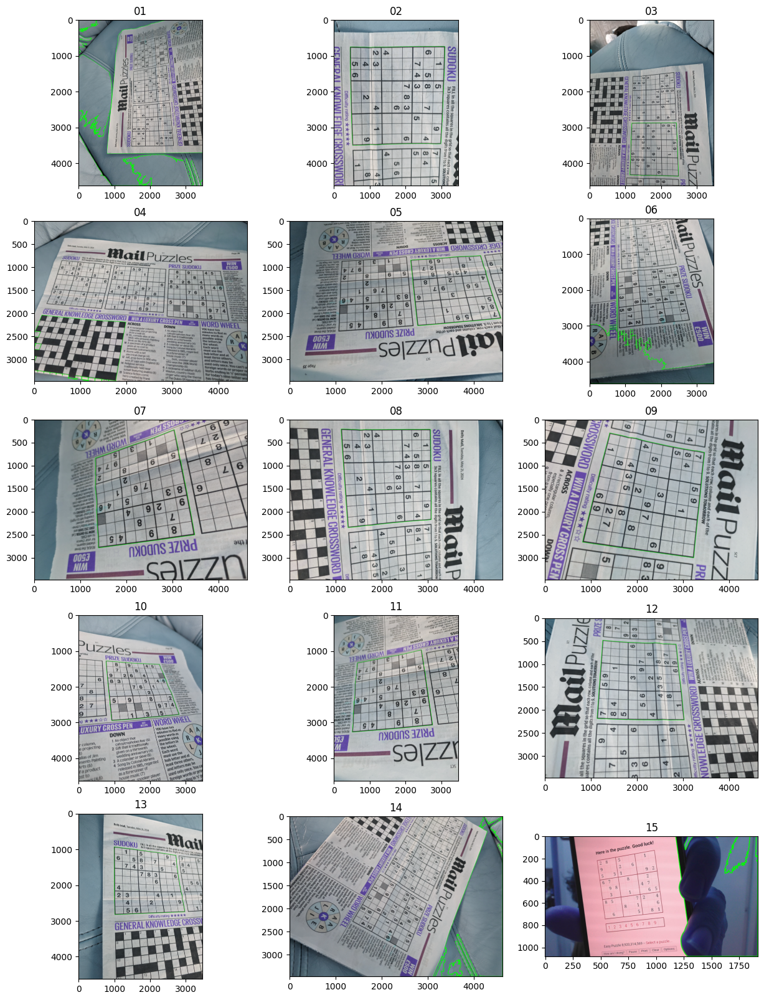

In [5]:
def find_biggest(contours):
    biggest = None
    largest_area = -1
    for cnt in contours:
        area = abs(cv2.contourArea(cnt))
        if area > largest_area:
            biggest = cnt
            largest_area = area
    return biggest

biggest_cnts = [find_biggest(cnts) for cnts in contours]

images_cpy = [(title, np.copy(img)) for title, img in images]
for (title, img), cnt in zip(images_cpy, biggest_cnts):
    cv2.drawContours(img, [cnt], -1, (0, 255, 0), 5)

show_images(images_cpy)

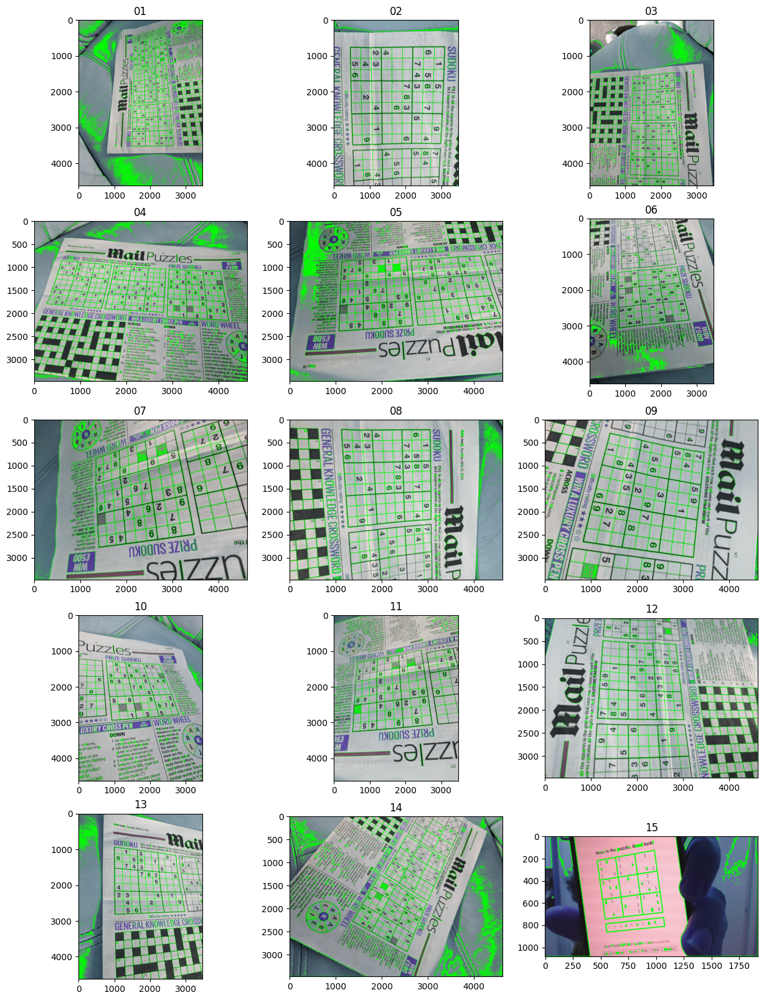

In [6]:
MIN_SOLID_RATIO = 0.85
def find_solids(contours):
    for cnt in contours:
        area = abs(cv2.contourArea(cnt))
        hull = cv2.convexHull(cnt)
        hull_area = abs(cv2.contourArea(hull))
        if hull_area == 0:
            continue
        solidity = float(area)/hull_area
        if solidity >= MIN_SOLID_RATIO:
            yield cnt

solid_cnts = [list(find_solids(cnts)) for cnts in contours]

images_cpy = [(title, np.copy(img)) for title, img in images]
for (title, img), cnts in zip(images_cpy, solid_cnts):
    cv2.drawContours(img, cnts, -1, (0, 255, 0), 5)

show_images(images_cpy)

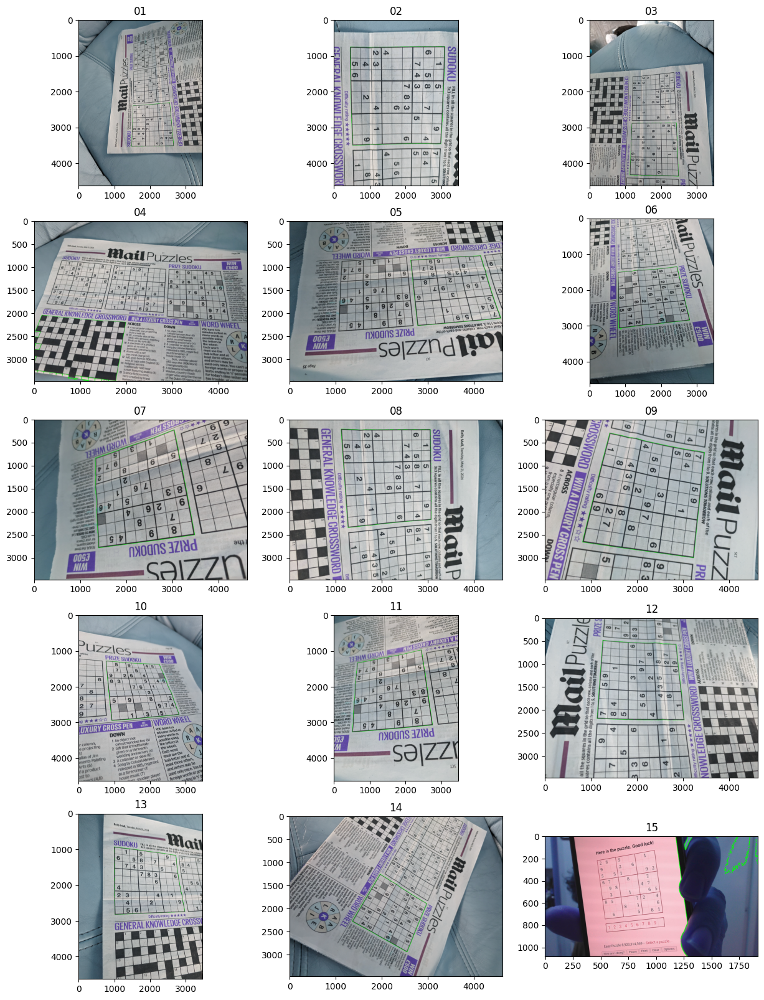

In [7]:
biggest_solid_cnts = [find_biggest(cnts) for cnts in solid_cnts]

images_cpy = [(title, np.copy(img)) for title, img in images]
for (title, img), cnts in zip(images_cpy, biggest_solid_cnts):
    cv2.drawContours(img, cnts, -1, (0, 255, 0), 5)

show_images(images_cpy)

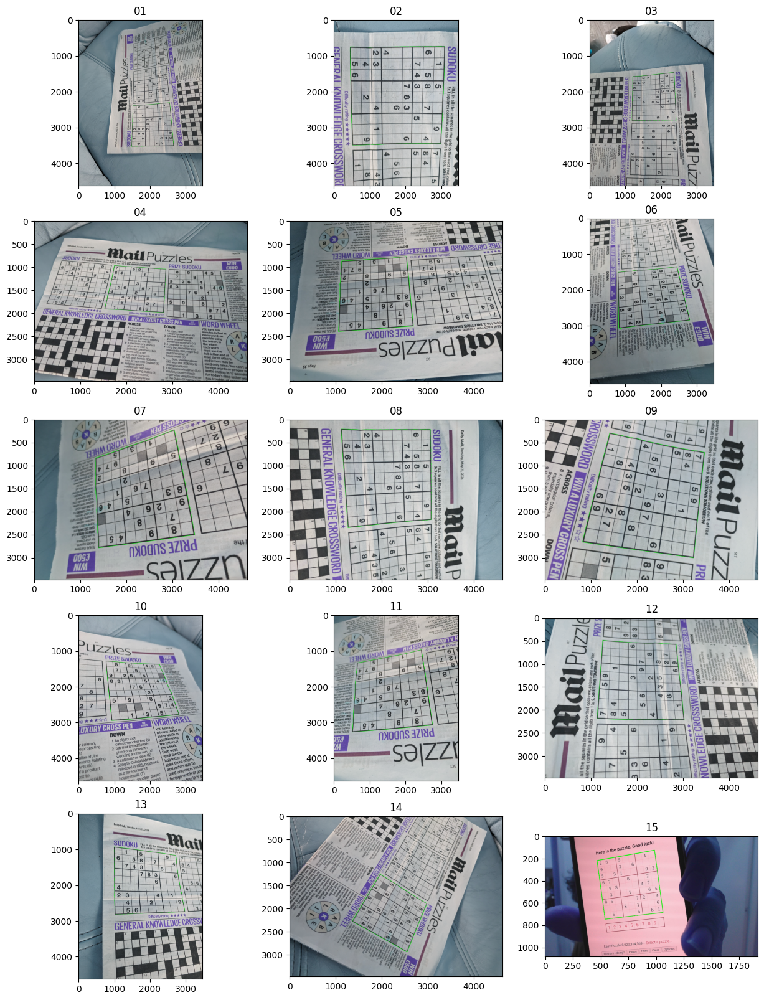

In [8]:
MAX_DISTANCE = 0.25

def distance_from_center(img, cnt):
    M = cv2.moments(cnt)
    cx = int(M['m10']/M['m00'])
    cy = int(M['m01']/M['m00'])
    height, width, _ = img.shape
    return (
        abs(cx - (width / 2)),
        abs(cy - (height / 2)),
    )

def near_center(img, cnts):
    for cnt in cnts:
        dx, dy = distance_from_center(img, cnt)
        height, width, _ = img.shape
    
        if dx / width > MAX_DISTANCE or dy / height > MAX_DISTANCE:
            continue

        yield cnt

biggest_solid_central_cnts = [
    find_biggest(list(near_center(img, cnts))) 
    for (_, img), cnts in zip(images, solid_cnts)
]

images_cpy = [(title, np.copy(img)) for title, img in images]
for (title, img), cnts in zip(images_cpy, biggest_solid_central_cnts):
    cv2.drawContours(img, cnts, -1, (0, 255, 0), 5)

show_images(images_cpy)
    

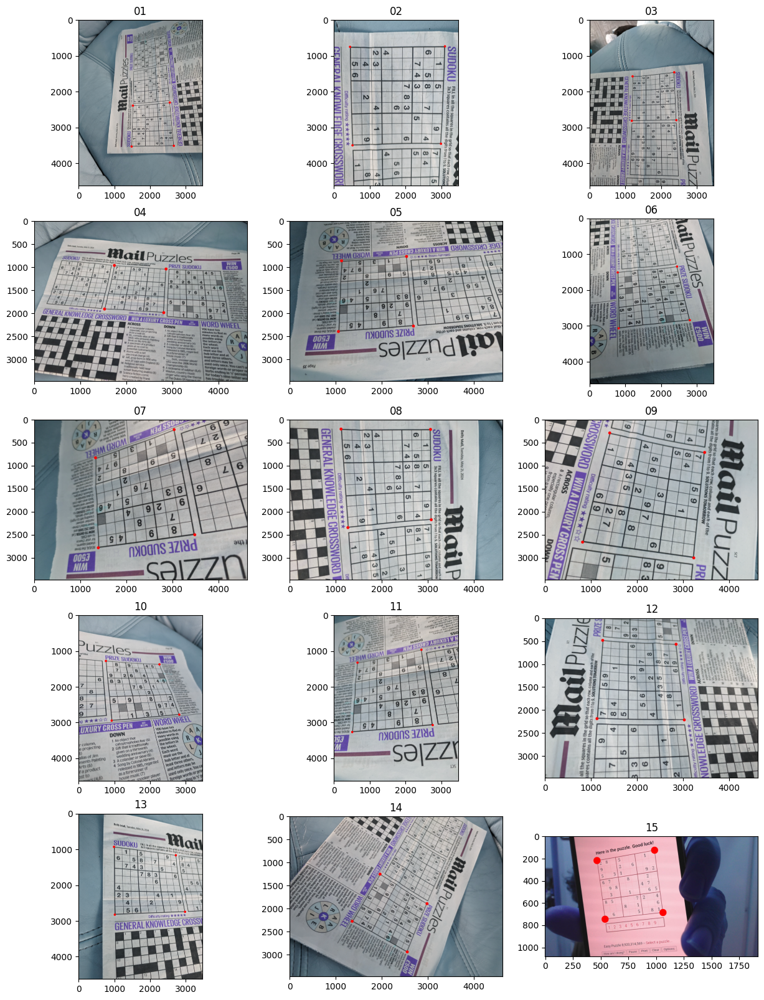

In [9]:
# Should really do this much earlier on to reduce the work done on
# all the contours...
ARC_LENGTH_THRESHOLD = 0.1
big_solid_squares = [
    cv2.approxPolyDP(
        cnt,
        ARC_LENGTH_THRESHOLD*cv2.arcLength(cnt,True),
        True,
    )
    for cnt in biggest_solid_central_cnts
]

images_cpy = [(title, np.copy(img)) for title, img in images]
for (title, img), cnts in zip(images_cpy, big_solid_squares):
    cv2.circle(img, cnts[0][0], 32, (255, 0, 0), -1)
    cv2.circle(img, cnts[1][0], 32, (255, 0, 0), -1)
    cv2.circle(img, cnts[2][0], 32, (255, 0, 0), -1)
    cv2.circle(img, cnts[3][0], 32, (255, 0, 0), -1)

show_images(images_cpy)

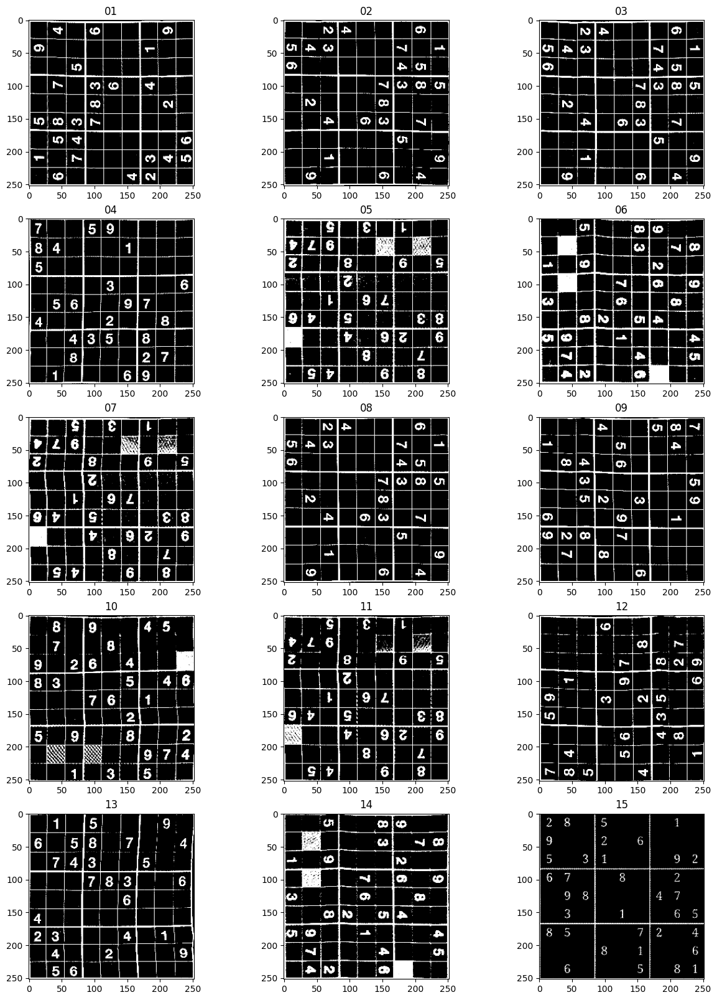

In [10]:
# Rotations had most luck at 300
RESULT_SIZE = 252
def sort_points(p):
    points = [point[0] for point in p]
    # Sort points based on their y-coordinates (y-values)
    points = sorted(points, key=lambda p: p[1])
    
    # The first two points are the top points and the last two are the bottom points
    top_points = points[:2]
    bottom_points = points[2:]
    
    # Sort the top points by their x-coordinates
    top_points = sorted(top_points, key=lambda p: p[0])
    top_left = top_points[0]
    top_right = top_points[1]
    
    # Sort the bottom points by their x-coordinates
    bottom_points = sorted(bottom_points, key=lambda p: p[0])
    bottom_left = bottom_points[0]
    bottom_right = bottom_points[1]
    
    return [top_left, top_right, bottom_left, bottom_right]

target = np.float32([
    [0,0],
    [RESULT_SIZE,0],
    [0,RESULT_SIZE],
    [RESULT_SIZE,RESULT_SIZE],
])

sorted_points = [np.float32(sort_points(box)) for box in big_solid_squares]

transforms = [
    cv2.getPerspectiveTransform(
        p,
        target
    )
    for p in sorted_points
]


warped = [
    (
        title, 
        cv2.warpPerspective(img, M, (RESULT_SIZE,RESULT_SIZE))
    )
    for (title, img), M in zip(inverted, transforms)
]

show_images(warped, 'grey')

2024-06-04 23:17:28.154954: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-06-04 23:17:28.238308: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-06-04 23:17:29.820931: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:984] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-06-04 23:17:29.843654: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:984] could not open file to read NUMA node: /sys/bus/pci/devi

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step
1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


I0000 00:00:1717543051.140558    8536 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


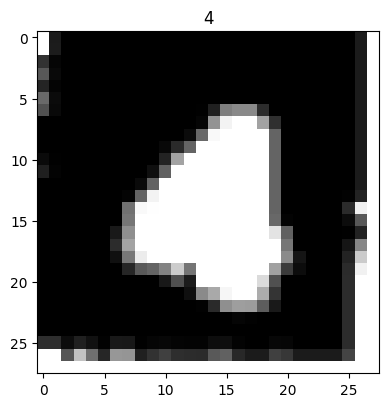

In [11]:
# Grabbing cell to test models...

cell_size = RESULT_SIZE//9
cell_coords = [0, 1]
padding = 1

y = int(cell_size * cell_coords[0])
x = int(cell_size * cell_coords[1])

test = warped[6][1][x+padding:x+cell_size-padding,y+padding:y+cell_size-padding]
test = cv2.resize(test, (28, 28))

import keras

digit_model = keras.models.load_model('models/digits_9961_1717539552.keras')
orientation_model = keras.models.load_model('models/orientations_9074_1717540204.keras')

result = orientation_model.predict(np.array([test]).reshape(-1, 28, 28, 1))
fix_rotation = [None, cv2.ROTATE_90_CLOCKWISE,cv2.ROTATE_180,cv2.ROTATE_90_COUNTERCLOCKWISE][np.argmax(result)]
print(fix_rotation)
if fix_rotation is not None:
    test = cv2.rotate(test, fix_rotation)

result = digit_model.predict(np.array([test]).reshape(-1, 28, 28, 1))
show_images([(np.argmax(result), test)], cmap='gray')

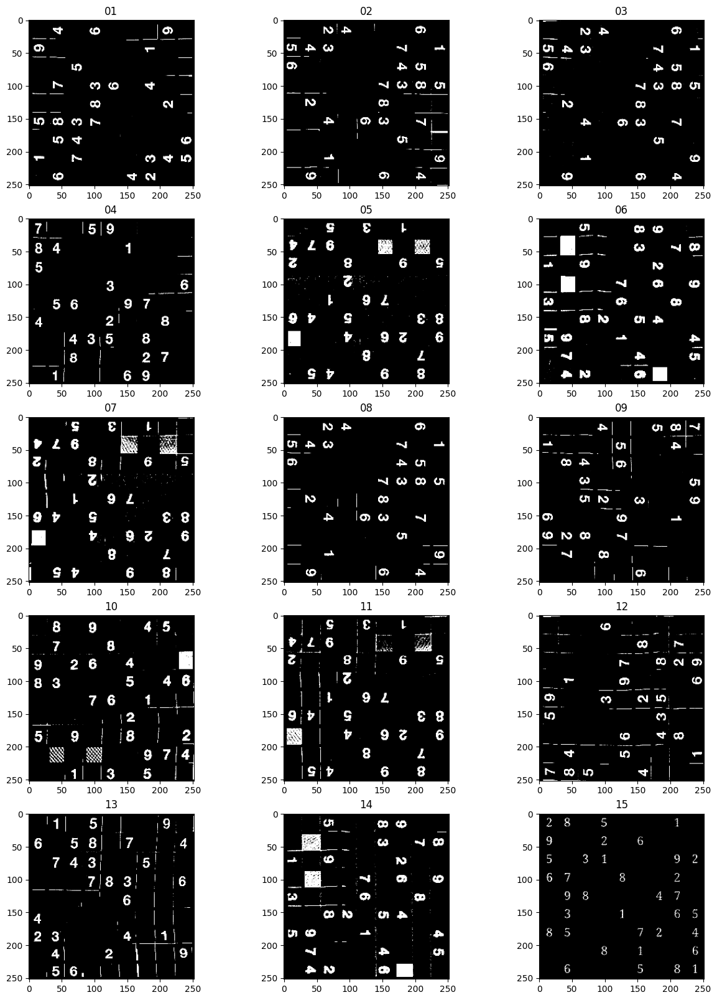

In [12]:
# Maybe don't need to remove the grid, just neeed to find the characters in each cell.
# Also would save on OCR on mostly empty cells
def remove_grid(img):
    edges = cv2.Canny(img,50,150,apertureSize = 3)
    
    lines = cv2.HoughLinesP(img,1,np.pi/180,65,minLineLength=45,maxLineGap=4)
    mask = np.zeros((RESULT_SIZE, RESULT_SIZE), dtype=np.uint8)
    
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))
    for line in lines:
        x1, y1, x2, y2 = line[0]
        
        cv2.line(mask,(x1,y1),(x2,y2),(255,0,0),2)
    mask = cv2.dilate(mask, kernel, iterations=2)
    removed = cv2.bitwise_and(img, np.invert(mask))
    return removed
    # return cv2.morphologyEx(removed, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2)), iterations=1)
    # eroded = cv2.erode(removed, cv2.getStructuringElement(cv2.MORPH_RECT, (1, 1)), iterations=1)
    return cv2.dilate(eroded, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2, 2)), iterations=1)


removed_grid = [(title, remove_grid(img)) for title, img in warped]
show_images(removed_grid, cmap='grey')

In [13]:
# 

# Removing horizontal and vertical lines for simpler OCR
# Based on
# https://stackoverflow.com/questions/71425968/remove-horizontal-lines-with-open-cv

# TODO: Already know ROUGHLY where the grid lines should be... can I just remove them? 
# def remove_grid(img):
#     h_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (36, 1))
#     v_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (1, 36))
#     d_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (10, 10))
#     o_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))
#     horizontal = cv2.morphologyEx(
#         img,
#         cv2.MORPH_OPEN,
#         h_kernel,
#         iterations=2,
#     )
#     vertical = cv2.morphologyEx(
#         img,
#         cv2.MORPH_OPEN,
#         v_kernel,
#         iterations=2,
#     )
#     grid = cv2.bitwise_or(
#         horizontal,
#         vertical,
#     )
#     dilated_grid = cv2.threshold(
#         cv2.dilate(grid, d_kernel,iterations = 1),
#         1,
#         255,
#         cv2.THRESH_BINARY,
#     )[1]
#     removed = cv2.bitwise_and(img, np.invert(dilated_grid))
#     opened = cv2.morphologyEx(removed, cv2.MORPH_OPEN, o_kernel, iterations=3)
#     return cv2.threshold(opened, 1, 255, cv2.THRESH_BINARY)[1]

# removed_grid = [(title, remove_grid(img)) for title, img in warped]
# show_images(removed_grid, cmap='grey')


{'Page number': '0', 'Orientation in degrees': '270', 'Rotate': '90', 'Orientation confidence': '0.39', 'Script': 'Katakana', 'Script confidence': '0.00'}
{'Page number': '0', 'Orientation in degrees': '90', 'Rotate': '270', 'Orientation confidence': '1.29', 'Script': 'Latin', 'Script confidence': '0.00'}
{'Page number': '0', 'Orientation in degrees': '90', 'Rotate': '270', 'Orientation confidence': '0.93', 'Script': 'Latin', 'Script confidence': '0.00'}
{'Page number': '0', 'Orientation in degrees': '0', 'Rotate': '0', 'Orientation confidence': '1.24', 'Script': 'Latin', 'Script confidence': '0.00'}
{'Page number': '0', 'Orientation in degrees': '180', 'Rotate': '180', 'Orientation confidence': '0.39', 'Script': 'Arabic', 'Script confidence': '1.67'}
{'Page number': '0', 'Orientation in degrees': '90', 'Rotate': '270', 'Orientation confidence': '0.56', 'Script': 'Latin', 'Script confidence': '1.67'}
{'Page number': '0', 'Orientation in degrees': '180', 'Rotate': '180', 'Orientation co

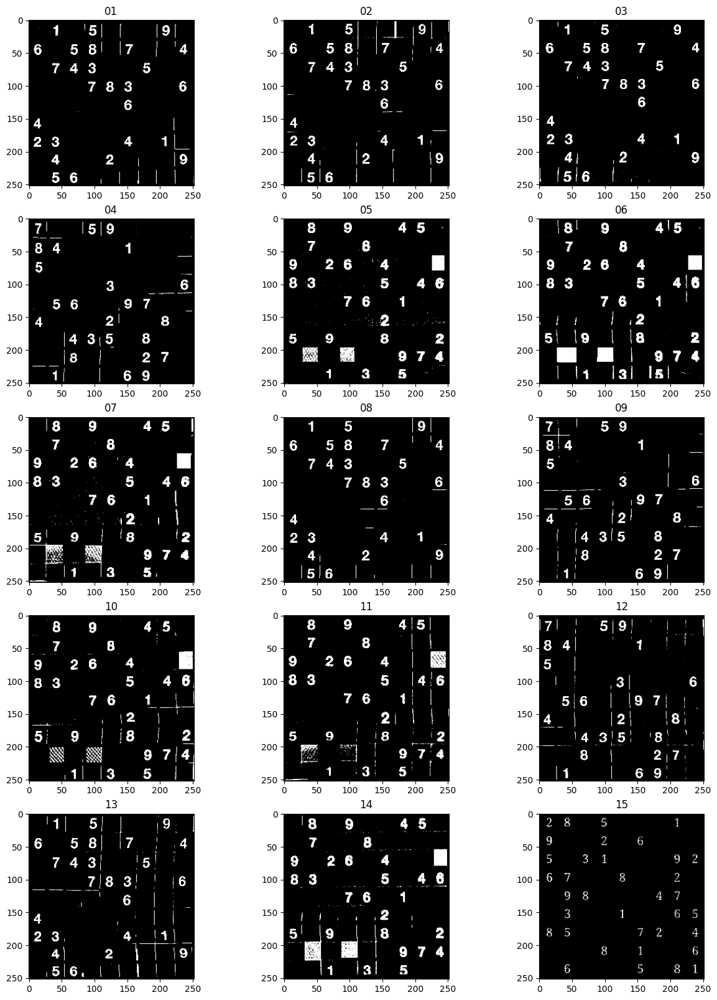

In [14]:
import pytesseract

def get_rotation(img):
    # img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # show_images([('foo', img)])
    result = pytesseract.image_to_osd(img, config='osd --psm 12 -c min_characters_to_try=15 nobatch digits')
    fields = [r.split(':') for r in result.split('\n')]
    data = {
        f[0].strip(): f[1].strip()
        for f in fields if len(f) == 2
    }
    print(data)
    rotation = int(data['Rotate'])
    if rotation == 90:
        return cv2.ROTATE_90_CLOCKWISE
    if rotation == 180:
        return cv2.ROTATE_180
    if rotation == 270:
        return cv2.ROTATE_90_COUNTERCLOCKWISE
    if rotation == 0:
        return None
    raise "Unexpected rotation from tesseract"

rotations = [
    get_rotation(img)
    for _, img in warped
]

rotated_warps = [
    (title, cv2.rotate(img, rotation)) if rotation is not None else (title, img)
    for (title, img), rotation in zip(removed_grid, rotations)
]

show_images(rotated_warps, 'grey')

In [15]:
PADDING = 0
def get_cells(img):
    height, width = img.shape
    cell_width = ceil(width/9)
    cell_height = ceil(height/9)
    
    cells = []
    for y in range(9):
        for x in range(9):
            cells.append(
                img[y*cell_height+PADDING:y*cell_height+cell_height-PADDING,x*cell_width+PADDING:x*cell_width+cell_width-PADDING]
            )
    return cells

def get_digit(img, min_conf=20):
    # return pytesseract.image_to_string(img, config='--psm 10 digits')

    data = pytesseract.image_to_data(img, config='--psm 10 nobatch digits')
    parts = data.split('\n')
    keys = parts[0].split('\t')
    values = [v.split('\t') for v in parts[1:]]
    data = [
        {
            keys[i]: v
            for i, v in enumerate(vals)
        }
        for vals in values
    ]
    high_conf = [
        d
        for d in data
        if float(d.get('conf', -1)) > min_conf and d.get('text', '').isnumeric()
    ]
    if len(high_conf) == 0:
        return None
    return int(max(high_conf, key=lambda d: d['conf'])['text'])
    

image_cells = [get_cells(img[1]) for img in removed_grid]
image_digits = [
    [get_digit(cell) for cell in cells]
    for cells in image_cells
]

[[None, None, None, 5, None, None, None, 1, None], [None, None, None, None, None, 6, None, None, None], [None, None, 3, None, None, None, None, 9, 4], [6, 7, None, None, None, None, None, None, None], [None, 9, 8, None, None, None, None, None, None], [None, None, None, None, None, None, None, 6, None], [None, None, None, None, None, None, None, None, None], [None, None, None, None, None, 1, None, None, 6], [None, 6, None, None, None, None, None, 8, None]]


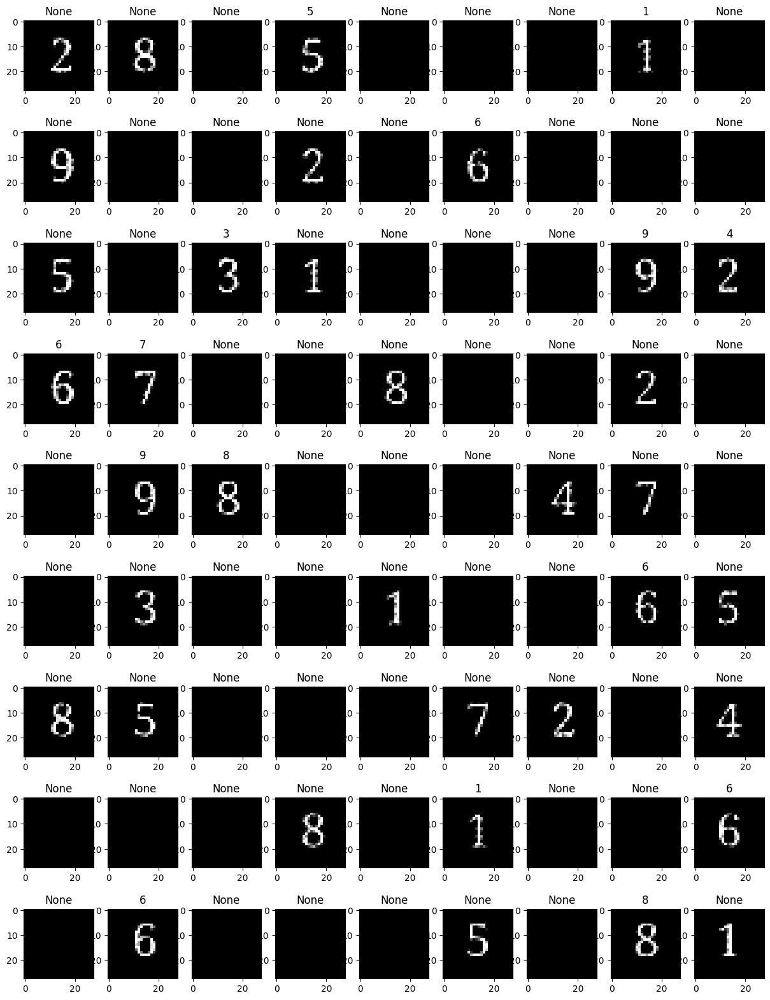

In [16]:
IMAGE_TO_CHECK = 14

check_cells = image_cells[IMAGE_TO_CHECK]
check_digits = [
    [image_digits[IMAGE_TO_CHECK]
     [y*9+x] for x in range(9)]
    for y in range(9)
]

print(check_digits)

show_images([(f"{digit}", img) for (digit, img) in zip([d for row in check_digits for d in row], check_cells)], columns=9, cmap='grey')

In [19]:
import sudoku

solved = []
for i, digits in enumerate(image_digits):
    grid = [
        [digits[y*9+x] for x in range(9)]
        for y in range(9)
    ]
    try:
        print(f"Solving {i}/{len(image_digits)}")
        solved.append(sudoku.solve(grid))
    except ValueError as e:
        print(f"Error solving {i}: {e}")
        solved.append(None)

print(f"Solved {len([s for s in solved if s is not None])}/{len(solved)}")

Solving 0/15
Solving 1/15
Solving 2/15
Solving 3/15
Solving 4/15
Solving 5/15
Solving 6/15
Solving 7/15
Solving 8/15
Error solving 8: Grid is invalid
Solving 9/15
Error solving 9: Grid is invalid
Solving 10/15
Solving 11/15
Error solving 11: Grid is invalid
Solving 12/15
Solving 13/15
Error solving 13: Grid is invalid
Solving 14/15
Solved 11/15


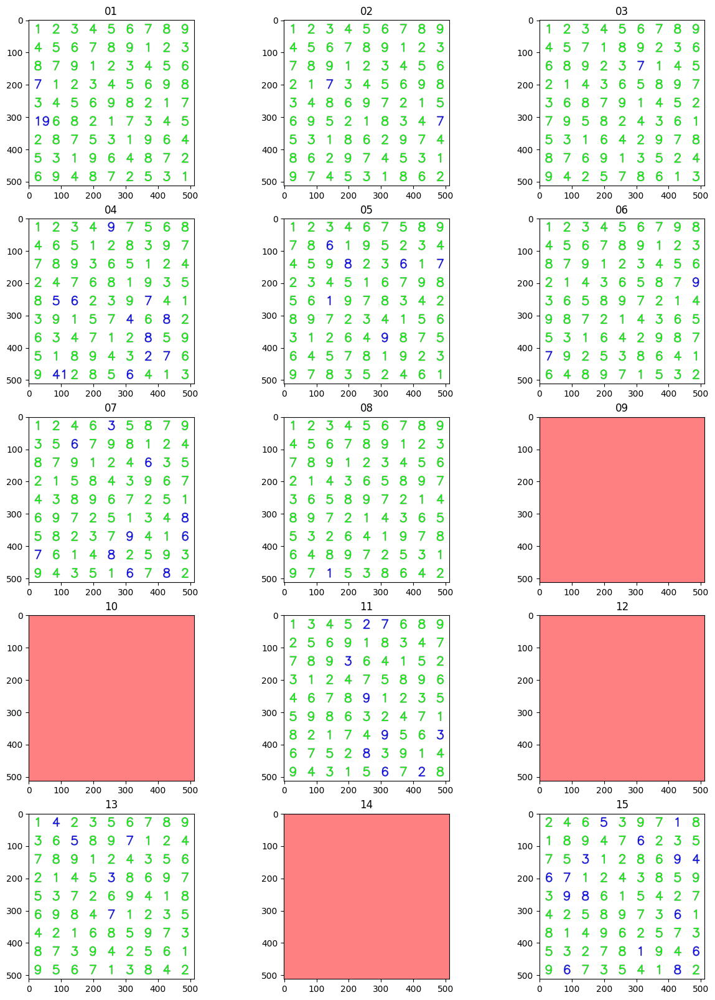

In [25]:
def get_digit_mask(solved, size=RESULT_SIZE, inset=16):
    cell_size = size / 9
    if solved is None:
        return np.full((size, size, 4), [255, 0, 0, 127], dtype=np.uint8)
    mask = np.zeros((size, size, 4), dtype=np.uint8)
    for y, row in enumerate(solved):
        for x, val in enumerate(row):
            point = (
                int(x * cell_size + inset),
                int(y * cell_size + cell_size - inset),
            )
            cv2.putText(
                mask,
                str(val["value"]),
                point,
                cv2.FONT_HERSHEY_SIMPLEX,
                1.25,
                (0, 255, 0, 255) if not val["locked"] else (0, 0, 255, 255),
                2,
                cv2.LINE_AA
            )
    return mask

digit_masks = [
    (title, get_digit_mask(s, size=512)) for (title, _), s in zip(images, solved)
]

show_images(digit_masks)

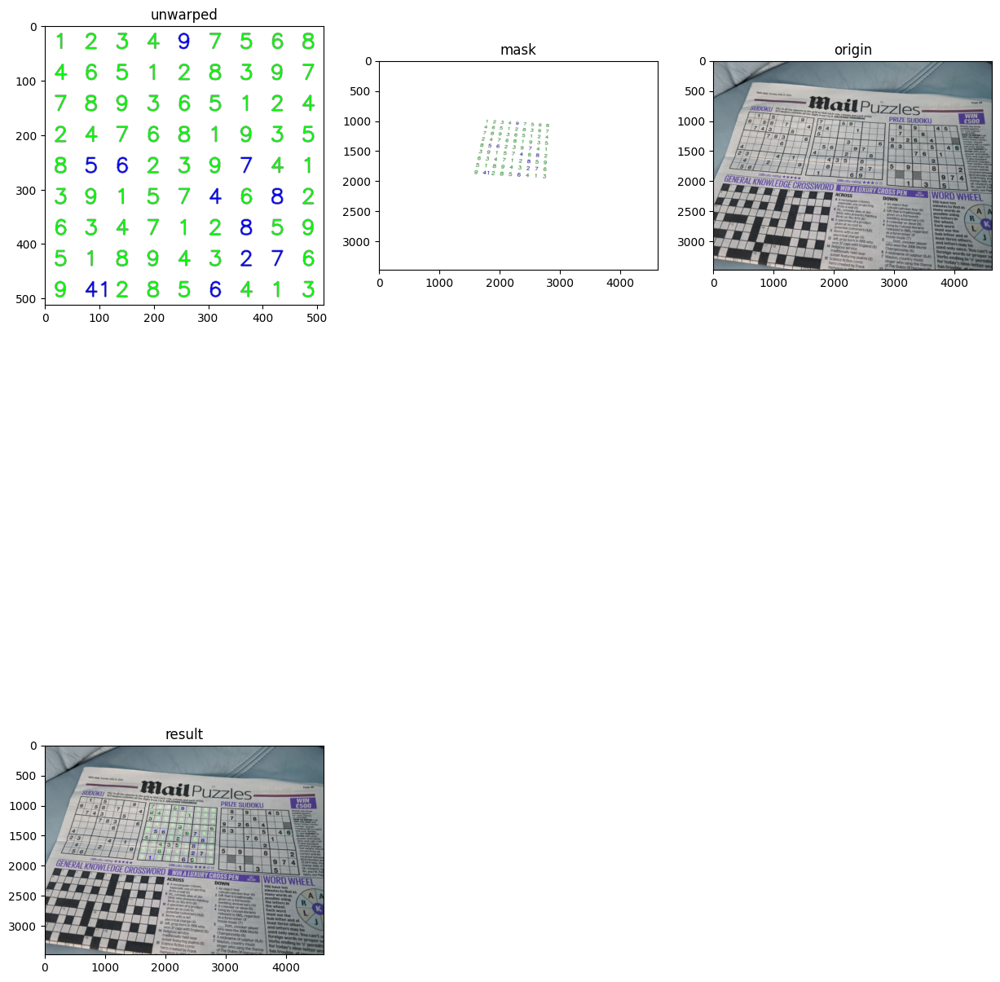

In [26]:
TO_CHECK = 3

UNDO_ROTATIONS = {
    cv2.ROTATE_90_CLOCKWISE: cv2.ROTATE_90_COUNTERCLOCKWISE,
    cv2.ROTATE_180: cv2.ROTATE_180,
    cv2.ROTATE_90_COUNTERCLOCKWISE: cv2.ROTATE_90_CLOCKWISE,
}

def undo_transform(img, rotation, sorted_points, initial_image):
    img_height, img_width, _ = img.shape
    initial_height, initial_width, _ = initial_image.shape
    if rotation is not None:
        img = cv2.rotate(img, UNDO_ROTATIONS[rotation])

    transform = cv2.getPerspectiveTransform(
        np.float32([
            [0,0],
            [img_width, 0],
            [0, img_height],
            [img_width, img_height],
        ]),
        sorted_points,
    )
    return cv2.warpPerspective(img, transform, (initial_width, initial_height))

def overlay_digits(digits, image):
    image_alpha = cv2.cvtColor(image, cv2.COLOR_BGR2BGRA)
    return cv2.addWeighted(digits, 1, image_alpha, 1, 0)
    # return np.uint8(np.where(digits == 0, image_alpha, digits))


test = undo_transform(digit_masks[TO_CHECK][1], rotations[TO_CHECK], sorted_points[TO_CHECK], images[TO_CHECK][1])
result = overlay_digits(test, images[TO_CHECK][1])
# result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
cv2.imwrite('test.png', result)
show_images([
    ('unwarped', digit_masks[TO_CHECK][1]),
    ('mask', test),
    ('origin', images[TO_CHECK][1]),
    ('result', result),
])

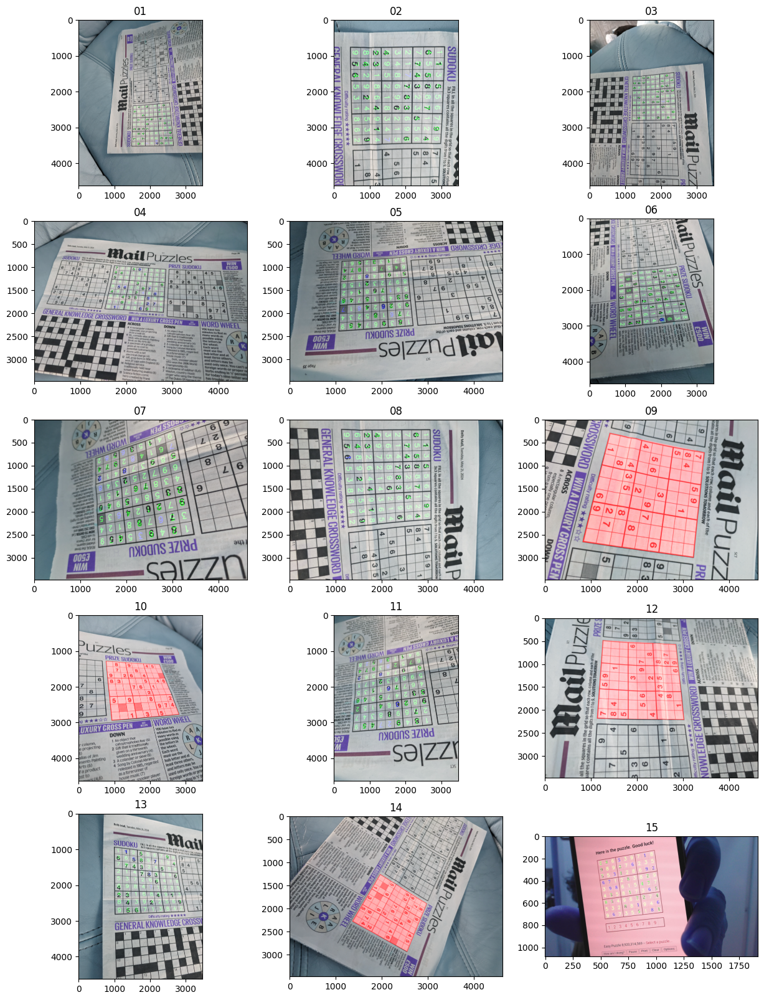

In [27]:
undone_transforms = [
    undo_transform(dm, r, sps, img)
    for (_, dm), r, sps, (title, img) in zip(digit_masks, rotations, sorted_points, images)
]

merged_images = [
    (title, overlay_digits(nums, img))
    for nums, (title, img) in zip(undone_transforms, images)
]

show_images(merged_images)

In [28]:
for title, img in merged_images:
    cv2.imwrite(f"results/{title}.png", img)